In [12]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from sklearn.preprocessing import StandardScaler
import numpy as np
from RegresionFunctions import test_regresion,cv_scorer,insert_into_summary,regresion_analysis, test_PCA, find_PCA, stepFeatureSelect,print_boxplots,RandSearch
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import power_transform
pd.set_option('display.max_columns', 60)
sns.set(rc={'figure.figsize':(15,15)})

%matplotlib inline

In [2]:
from sklearn.linear_model import LinearRegression,TweedieRegressor, Ridge, Lasso, ElasticNet, BayesianRidge,PoissonRegressor
import xgboost as xgb
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor,ExtraTreesRegressor
from sklearn.neighbors import KNeighborsRegressor

In [3]:
from sklearn.feature_selection import SelectKBest,f_regression

In [4]:
data = pd.read_csv('FBCommentsDataset.csv', header=None)
data.set_axis(['page_likes','no_visitors','talking_about','category','min_C1','max_C1','avg_C1','median_C1','std_dev_C1','min_C2','max_C2','avg_C2','median_C2','std_dev_C2','min_C3','max_C3','avg_C3','median_C3','std_dev_C3','min_C4','max_C4','avg_C4','median_C4','std_dev_C4','min_C5','max_C5','avg_C5','median_C5','std_dev_C5','C1','C2','C3','C4','C5','base_time','post_length','shares','promotion','target_h','mon_pub','tue_pub','wed_pub','thu_pub','fri_pub','sat_pub','sun_pub','mon_observ','tue_observ','wed_observ','thu_observ','fri_observ','sat_observ','sun_observ','no_comments_target_h'], axis=1, inplace=True)

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40949 entries, 0 to 40948
Data columns (total 54 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   page_likes            40949 non-null  int64  
 1   no_visitors           40949 non-null  int64  
 2   talking_about         40949 non-null  int64  
 3   category              40949 non-null  int64  
 4   min_C1                40949 non-null  float64
 5   max_C1                40949 non-null  float64
 6   avg_C1                40949 non-null  float64
 7   median_C1             40949 non-null  float64
 8   std_dev_C1            40949 non-null  float64
 9   min_C2                40949 non-null  float64
 10  max_C2                40949 non-null  float64
 11  avg_C2                40949 non-null  float64
 12  median_C2             40949 non-null  float64
 13  std_dev_C2            40949 non-null  float64
 14  min_C3                40949 non-null  float64
 15  max_C3             

In [6]:
data.head(10)

,page_likes,no_visitors,talking_about,category,min_C1,max_C1,avg_C1,median_C1,std_dev_C1,min_C2,max_C2,avg_C2,median_C2,std_dev_C2,min_C3,max_C3,avg_C3,median_C3,std_dev_C3,min_C4,max_C4,avg_C4,median_C4,std_dev_C4,min_C5,max_C5,avg_C5,median_C5,std_dev_C5,C1,C2,C3,C4,C5,base_time,post_length,shares,promotion,target_h,mon_pub,tue_pub,wed_pub,thu_pub,fri_pub,sat_pub,sun_pub,mon_observ,tue_observ,wed_observ,thu_observ,fri_observ,sat_observ,sun_observ,no_comments_target_h
0,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,65,166,2,0,24,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
1,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,10,132,1,0,24,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0
2,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,14,133,2,0,24,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0
3,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,7,0,3,7,-3,62,131,1,0,24,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0
4,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,1,0,0,1,0,58,142,5,0,24,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
5,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,60,166,1,0,24,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
6,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,68,145,2,0,24,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
7,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,1,0,1,1,-1,32,157,2,0,24,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0
8,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,35,177,5,0,24,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0
9,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,48,126,1,0,24,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0


In [7]:
data.describe()

,page_likes,no_visitors,talking_about,category,min_C1,max_C1,avg_C1,median_C1,std_dev_C1,min_C2,max_C2,avg_C2,median_C2,std_dev_C2,min_C3,max_C3,avg_C3,median_C3,std_dev_C3,min_C4,max_C4,avg_C4,median_C4,std_dev_C4,min_C5,max_C5,avg_C5,median_C5,std_dev_C5,C1,C2,C3,C4,C5,base_time,post_length,shares,promotion,target_h,mon_pub,tue_pub,wed_pub,thu_pub,fri_pub,sat_pub,sun_pub,mon_observ,tue_observ,wed_observ,thu_observ,fri_observ,sat_observ,sun_observ,no_comments_target_h
count,4.094900e+04,40949.000000,4.094900e+04,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.0,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000,40949.000000
mean,1.313814e+06,4676.133752,4.480025e+04,24.254780,1.586241,443.333854,55.720384,35.645535,67.464151,0.219468,285.187428,22.186647,7.503724,40.474206,0.024103,268.358275,19.649686,4.921537,38.728848,1.497253,415.395297,52.631591,34.042370,63.154906,-220.046619,275.403722,2.536961,-2.020904,55.840996,55.720384,22.186647,19.649686,52.631591,2.536961,35.322035,163.652470,117.249823,0.0,23.767833,0.122347,0.143300,0.149747,0.157489,0.144033,0.146157,0.136926,0.141640,0.132506,0.137635,0.148599,0.150846,0.143886,0.144888,7.322889
std,6.785752e+06,20593.184863,1.109338e+05,19.950583,20.753174,496.695198,86.933548,69.960232,81.568249,10.055146,374.441728,36.930662,21.778756,54.277774,1.981360,327.063844,31.094112,13.245799,50.846434,18.715475,472.380251,81.264281,66.153081,76.403985,281.814185,373.330611,17.544907,14.720873,73.811134,136.975705,77.124263,71.078576,128.179920,94.202974,20.916864,376.264387,945.006667,0.0,1.919829,0.327691,0.350383,0.356828,0.364265,0.351127,0.353268,0.343774,0.348684,0.339045,0.344520,0.355698,0.357903,0.350979,0.351992,35.494550
min,3.600000e+01,0.000000,0.000000e+00,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1366.000000,-204.000000,-210.500000,-288.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1366.000000,0.000000,0.000000,1.000000,0.0,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.673400e+04,0.000000,6.980000e+02,9.000000,0.000000,45.000000,5.527273,2.000000,8.278756,0.000000,26.000000,1.911290,0.000000,4.109465,0.000000,26.000000,2.030303,0.000000,4.094580,0.000000,42.000000,5.218182,2.000000,7.600215,-310.000000,23.000000,-0.483221,-2.000000,5.990950,2.000000,0.000000,0.000000,2.000000,-6.000000,17.000000,38.000000,2.000000,0.0,24.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2.929110e+05,0.000000,7.045000e+03,18.000000,0.000000,241.000000,23.374101,12.000000,35.069140,0.000000,118.000000,8.437500,2.000000,17.382709,0.000000,116.000000,8.584270,1.000000,18.639984,0.000000,224.000000,21.859375,12.000000,32.368848,-92.000000,109.000000,0.273810,0.000000,25.547172,11.000000,2.000000,0.000000,10.000000,0.000000,35.000000,97.000000,13.000000,0.0,24.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.204214e+06,99.000000,5.026400e+04,32.000000,0.000000,717.000000,71.828829,42.000000,102.554954,0.000000,405.000000,29.005525,8.000000,60.760334,0.000000,381.000000,24.842520,5.000000,54.523165,0.000000,676

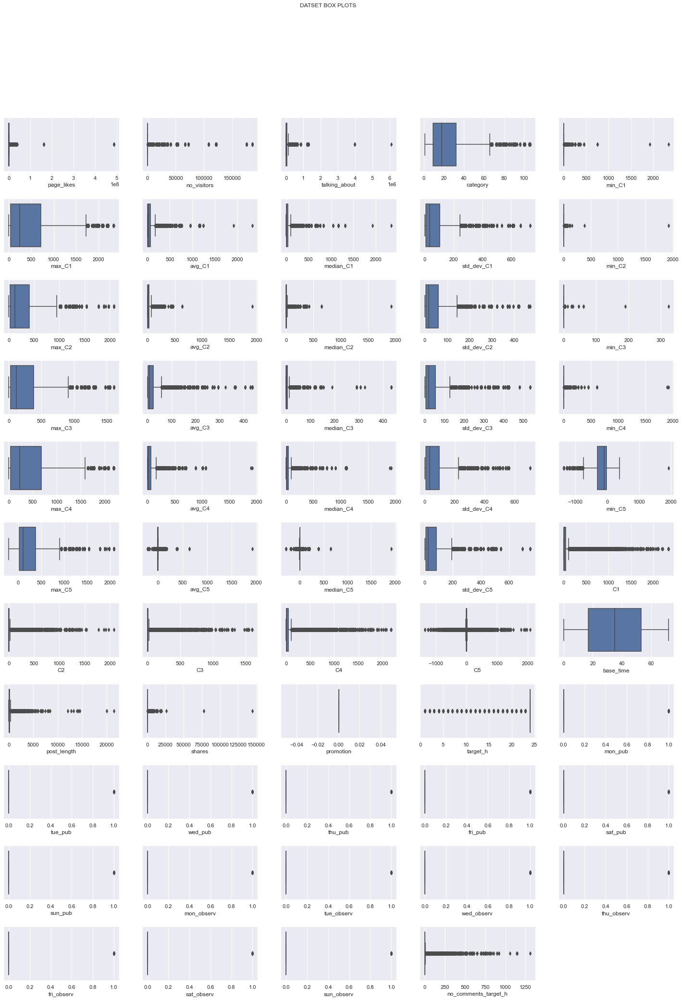

In [8]:
print_boxplots(data)

In [8]:
data.drop(['promotion'],axis=1, inplace=True)

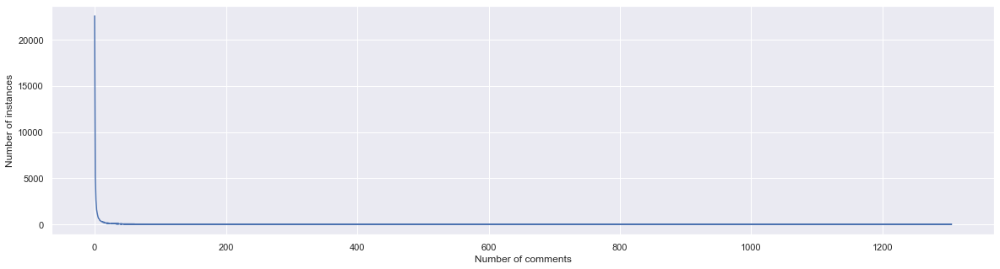

In [132]:
plt.figure(figsize=(20,5))
ax=(data['no_comments_target_h'].value_counts()).plot()
ax.set_ylabel("Number of instances")
ax.set_xlabel("Number of comments");

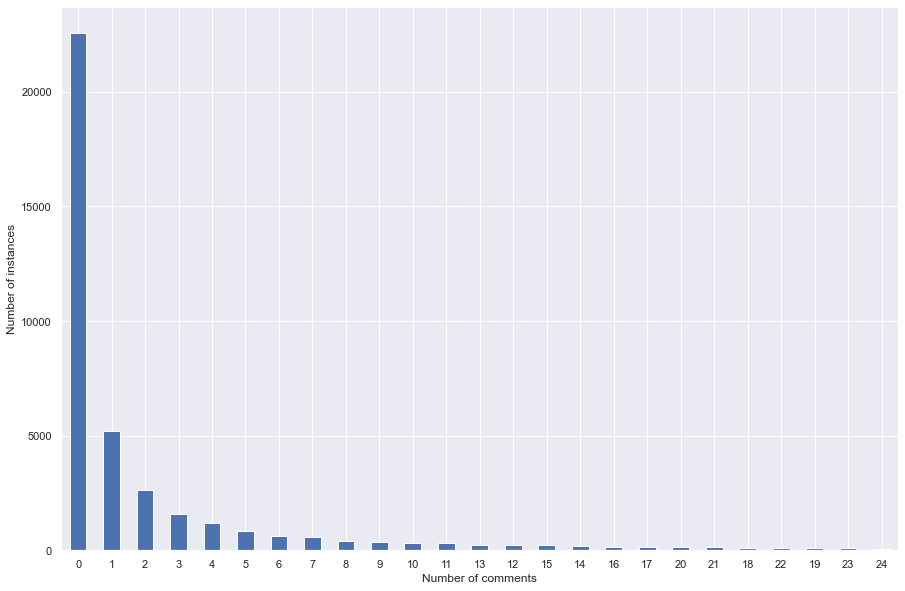

In [131]:
plt.figure(figsize=(15,10))
ax=data['no_comments_target_h'].value_counts().head(25).plot.bar(rot=0)
ax.set_ylabel("Number of instances")
ax.set_xlabel("Number of comments");

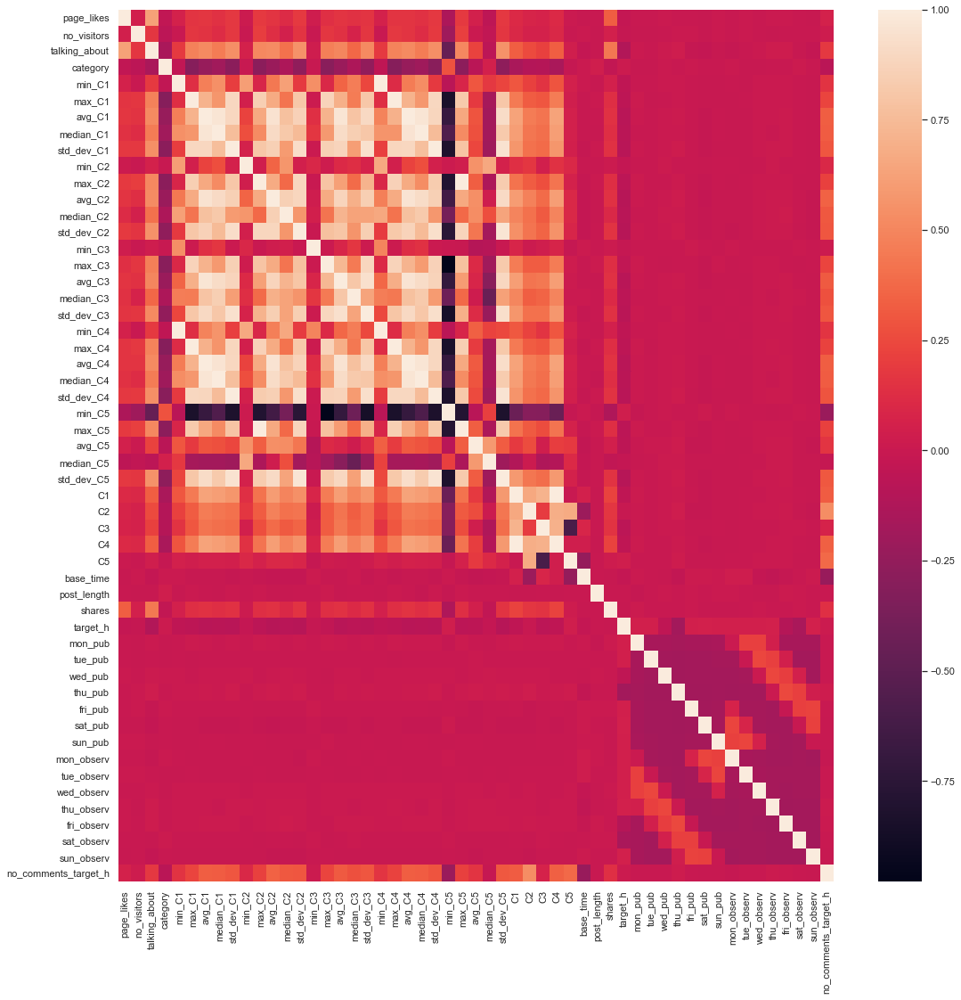

In [12]:
plt.figure(figsize=(18,18))
sns.heatmap(data.corr());

In [41]:
start_dict={
    'LinearRegression':LinearRegression(),
    'TweedieRegressor':TweedieRegressor(),
    'XGB':xgb.XGBRegressor(),
    'SVR':SVR(),
    'DecisionTreeRegressor':DecisionTreeRegressor(max_depth=80,random_state=1),
    'RandomForestRegressor':RandomForestRegressor(n_estimators=40,max_depth=20,random_state=1),
    'ExtraTreesRegressor':ExtraTreesRegressor(n_estimators=40,max_depth=20,random_state=1),
    'KNeighborsRegressor':KNeighborsRegressor(),
    'Ridge':Ridge(random_state=1),
    'Lasso':Lasso(random_state=1),
    'ElasticNet':ElasticNet(random_state=1),
    'BayesianRidge':BayesianRidge()
}

In [34]:
summaryDF=pd.DataFrame(index=['LinearRegression','TweedieRegressor','XGB','SVR','DecisionTreeRegressor','RandomForestRegressor','ExtraTreesRegressor','KNeighborsRegressor','Ridge', 'Lasso','ElasticNet','BayesianRidge'],columns=['R2','MAE','MSE','CV-R2'])

# Original dataset without data preprocessing

In [17]:
X_org=data.iloc[:,0:-1]
y_org=data.iloc[:,-1:]

In [18]:
for name,regressor in start_dict.items():
    regresion_analysis(regressor,X_org,y_org,name,summaryDF,train=0.8)

PoissonRegressor: 
LinearRegression: 
TweedieRegressor: 
XGB: 
SVR: 
DecisionTreeRegressor: 
RandomForestRegressor: 
ExtraTreesRegressor: 
KNeighborsRegressor: 
Ridge: 
Lasso: 
ElasticNet: 
BayesianRidge: 


In [22]:
summaryDF.to_pickle('summaryDF.pkl')
summaryDF.sort_values('CV-R2', ascending=False)

,R2,MAE,MSE,CV-R2
ExtraTreesRegressor,0.572259,4.07373,433.347,0.599296
RandomForestRegressor,0.563324,4.01344,442.399,0.597131
XGB,0.596091,3.92994,409.203,0.57844
DecisionTreeRegressor,0.231891,5.30977,778.176,0.316316
KNeighborsRegressor,0.188838,5.95043,821.794,0.291306
ElasticNet,0.282344,7.46451,727.062,0.25688
TweedieRegressor,0.272676,7.52951,736.857,0.25532
Lasso,0.286961,7.31738,722.384,0.249078
Ridge,0.275645,8.20534,733.849,0.214277
BayesianRidge,0.275628,8.1681,733.866,0.214004


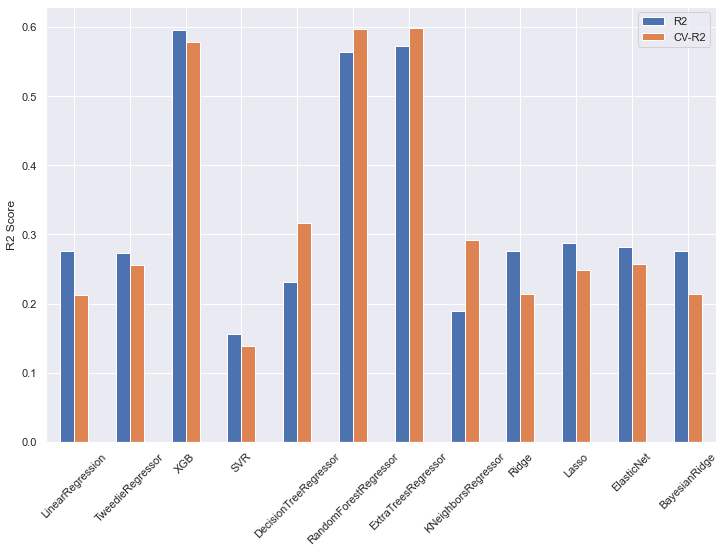

In [130]:
ax=summaryDF.plot( y=['R2', 'CV-R2'], kind="bar",rot=45,figsize=(12,8))
ax.set_ylabel("R2 Score");

## Best regressors
### 1. ExtraTreesRegressor
### 2. RandomForestRegressor
### 3. XGB
### 4. KNeighborsRegressor
### 5. DecisionTreeRegressor


In [9]:
regressor_dict={
    'XGB':xgb.XGBRegressor(),
    'DecisionTreeRegressor':DecisionTreeRegressor(max_depth=80,random_state=1),
    'RandomForestRegressor':RandomForestRegressor(n_estimators=40,max_depth=20,random_state=1),
    'KNeighborsRegressor':KNeighborsRegressor(),
    'ExtraTreesRegressor':ExtraTreesRegressor(n_estimators=40,max_depth=20,random_state=1)
}

In [10]:
summaryDF=pd.read_pickle('summaryDF.pkl')

In [11]:
templateDF=pd.DataFrame(summaryDF.sort_values('CV-R2', ascending=False).iloc[0:5,:])
templateDF['baseCV-R2']=templateDF['CV-R2']

# SKEW DATA

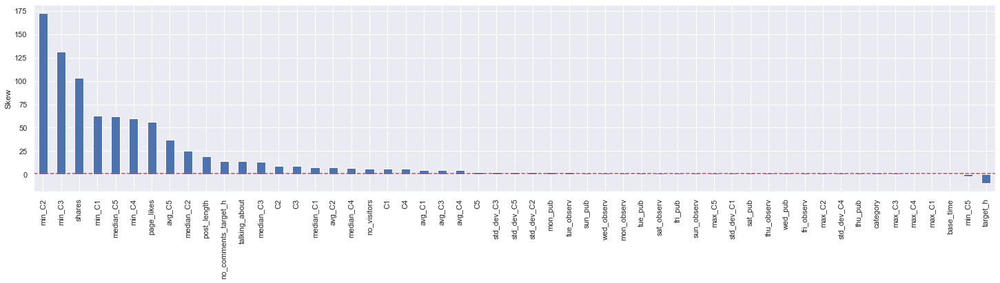

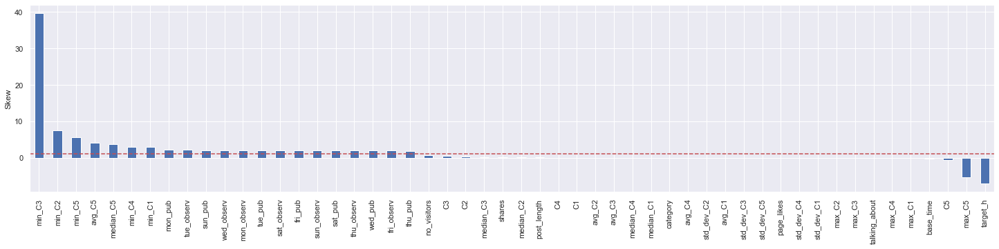

In [129]:
plt.figure(figsize=(25,5))
plt.axhline(y = 1, color='r', linestyle='--', label = 'skew border')
ax=data.skew().sort_values(ascending=False).plot.bar();
ax.set_ylabel("Skew");

X_scew=pd.DataFrame(power_transform(data.drop(['no_comments_target_h'],axis=1)),columns=data.columns.drop(['no_comments_target_h']),index=data.index)
y_scew=data['no_comments_target_h']
plt.figure(figsize=(25,5))
plt.axhline(y = 1, color='r', linestyle='--', label = 'skew border')
ax=X_scew.skew().sort_values(ascending=False).plot.bar();
ax.set_ylabel("Skew");

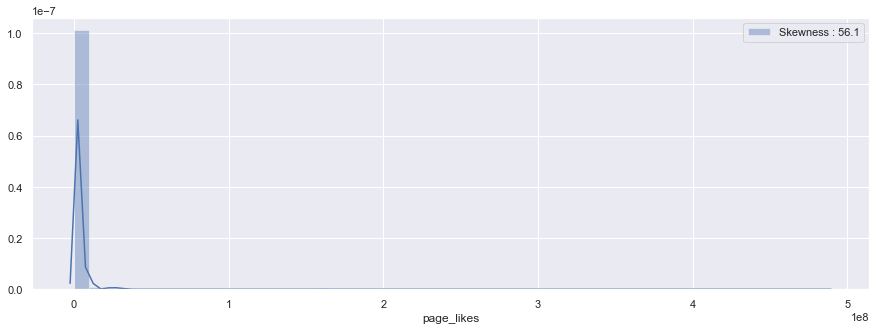

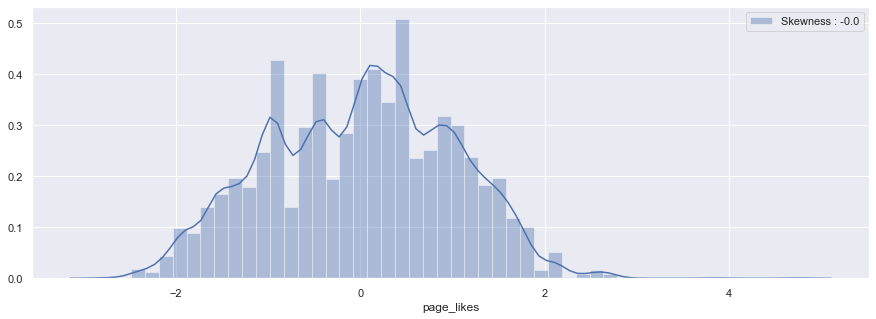

In [29]:
plt.figure(figsize=(15,5))
plot = sns.distplot((data['page_likes']), color="b", label="Skewness : %.1f"%((data['page_likes']).skew()))
plot = plot.legend(loc="best")
plt.figure(figsize=(15,5))
plot = sns.distplot((X_scew['page_likes']), color="b", label="Skewness : %.1f"%((X_scew['page_likes']).skew()))
plot = plot.legend(loc="best")

In [39]:
summary_scewDF=summaryDF.copy()
summary_scewDF['base_CV-R2']=summaryDF['CV-R2']

In [42]:
for name,regressor in start_dict.items():
    regresion_analysis(regressor,X_scew,y_scew,name,summary_scewDF,train=0.80)

LinearRegression: 
TweedieRegressor: 
XGB: 
SVR: 
DecisionTreeRegressor: 
RandomForestRegressor: 
ExtraTreesRegressor: 
KNeighborsRegressor: 
Ridge: 
Lasso: 
ElasticNet: 
BayesianRidge: 


In [43]:
summary_scewDF.to_pickle('summary_scewDF.pkl')
summary_scewDF.sort_values('CV-R2', ascending=False)

,R2,MAE,MSE,CV-R2,base_CV-R2
ExtraTreesRegressor,0.569698,4.083,435.942,0.612631,0.599296
RandomForestRegressor,0.571109,4.01741,434.513,0.599332,0.597131
XGB,0.575362,4.04612,430.204,0.578566,0.57844
KNeighborsRegressor,0.267852,5.81265,741.744,0.290183,0.291306
DecisionTreeRegressor,0.143595,5.4337,867.629,0.278957,0.316316
Ridge,0.23622,11.026,773.791,0.224297,0.214277
LinearRegression,0.235197,11.074,774.827,0.224236,0.212979
BayesianRidge,0.236634,10.9657,773.371,0.223922,0.214004
Lasso,0.217355,9.91486,792.902,0.212649,0.249078
ElasticNet,0.211015,9.38029,799.326,0.203215,0.25688


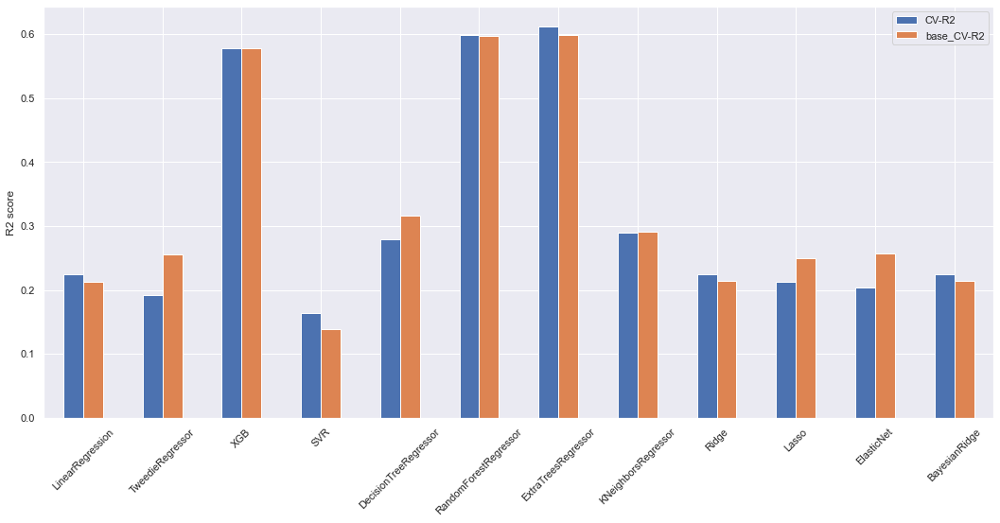

In [128]:
ax=summary_scewDF.plot( y=['CV-R2', 'base_CV-R2'], kind="bar",rot=45,figsize=(18,8))
ax.set_ylabel("R2 score");

# Data with combined day columns (reverse OneHot encoding for published and observed days)

In [45]:
X_comb_day=data.iloc[:,0:-1]
y_comb_day=data.iloc[:,-1:]
X_comb_day['published']=X_comb_day['tue_pub']+X_comb_day['wed_pub']*2+X_comb_day['thu_pub']*3+X_comb_day['fri_pub']*4+X_comb_day['sat_pub']*5+X_comb_day['sun_pub']*6
X_comb_day['observed']=X_comb_day['tue_observ']+X_comb_day['wed_observ']*2+X_comb_day['thu_observ']*3+X_comb_day['fri_observ']*4+X_comb_day['sat_observ']*5+X_comb_day['sun_observ']*6
X_comb_day.drop(['mon_pub','tue_pub','wed_pub','thu_pub','fri_pub','sat_pub','sun_pub','mon_observ','tue_observ','wed_observ','thu_observ','fri_observ','sat_observ','sun_observ'], axis=1, inplace=True)
X_comb_day.head(5)

,page_likes,no_visitors,talking_about,category,min_C1,max_C1,avg_C1,median_C1,std_dev_C1,min_C2,max_C2,avg_C2,median_C2,std_dev_C2,min_C3,max_C3,avg_C3,median_C3,std_dev_C3,min_C4,max_C4,avg_C4,median_C4,std_dev_C4,min_C5,max_C5,avg_C5,median_C5,std_dev_C5,C1,C2,C3,C4,C5,base_time,post_length,shares,target_h,published,observed
0,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,65,166,2,24,3,6
1,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,10,132,1,24,4,5
2,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,14,133,2,24,5,6
3,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,7,0,3,7,-3,62,131,1,24,5,1
4,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,1,0,0,1,0,58,142,5,24,1,3


In [46]:
summary_days_comDF=templateDF.copy()

In [47]:
for name,regressor in regressor_dict.items():
    regresion_analysis(regressor,X_comb_day,y_comb_day,name,summary_days_comDF,train=0.80)

XGB: 
DecisionTreeRegressor: 
RandomForestRegressor: 
KNeighborsRegressor: 
ExtraTreesRegressor: 


In [48]:
summary_days_comDF.to_pickle('summary_days_comDF.pkl')
summary_days_comDF.sort_values('CV-R2', ascending=False)

,R2,MAE,MSE,CV-R2,baseCV-R2
RandomForestRegressor,0.568407,4.02381,437.25,0.603178,0.597131
ExtraTreesRegressor,0.559092,4.10057,446.687,0.601072,0.599296
XGB,0.569189,4.10175,436.457,0.584329,0.57844
DecisionTreeRegressor,0.220886,5.27045,789.326,0.334092,0.316316
KNeighborsRegressor,0.202599,5.69619,807.852,0.285407,0.291306


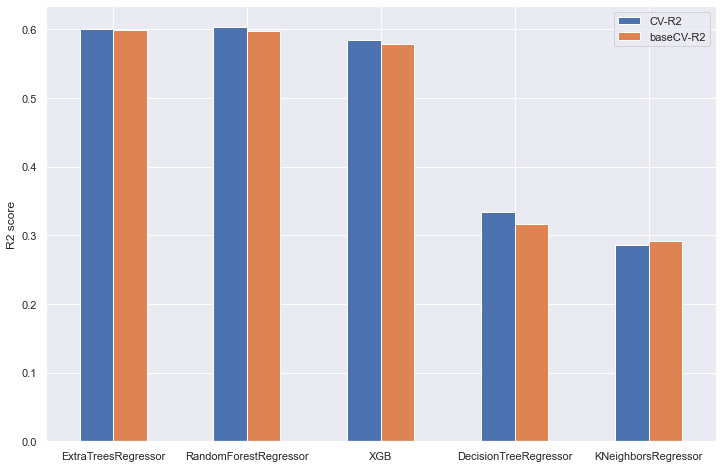

In [127]:
ax=summary_days_comDF.plot( y=['CV-R2','baseCV-R2'], kind="bar",rot=0,figsize=(12,8))
ax.set_ylabel("R2 score");

# Data with combined day columns to form workday/weekend relation (reverse OneHot encoding for published and observed days)

In [51]:
X_comb_day2=data.iloc[:,0:-1]
y_comb_day2=data.iloc[:,-1:]
X_comb_day2['workday_published']=X_comb_day2['mon_pub']+X_comb_day2['tue_pub']+X_comb_day2['wed_pub']+X_comb_day2['thu_pub']+X_comb_day2['fri_pub'] 
X_comb_day2['weekend_published']=X_comb_day2['sat_pub']+X_comb_day2['sun_pub']

X_comb_day2['workday_observed']=X_comb_day2['mon_observ']+X_comb_day2['tue_observ']+X_comb_day2['wed_observ']+X_comb_day2['thu_observ']+X_comb_day2['fri_observ'] 
X_comb_day2['weekend_observed']=X_comb_day2['sat_observ']+X_comb_day2['sun_observ']

X_comb_day2.drop(['mon_pub','tue_pub','wed_pub','thu_pub','fri_pub','sat_pub','sun_pub','mon_observ','tue_observ','wed_observ','thu_observ','fri_observ','sat_observ','sun_observ'], axis=1, inplace=True)
X_comb_day2.head(5)

,page_likes,no_visitors,talking_about,category,min_C1,max_C1,avg_C1,median_C1,std_dev_C1,min_C2,max_C2,avg_C2,median_C2,std_dev_C2,min_C3,max_C3,avg_C3,median_C3,std_dev_C3,min_C4,max_C4,avg_C4,median_C4,std_dev_C4,min_C5,max_C5,avg_C5,median_C5,std_dev_C5,C1,C2,C3,C4,C5,base_time,post_length,shares,target_h,workday_published,weekend_published,workday_observed,weekend_observed
0,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,65,166,2,24,1,0,0,1
1,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,10,132,1,24,1,0,0,1
2,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,0,0,0,0,0,14,133,2,24,0,1,0,1
3,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,7,0,3,7,-3,62,131,1,24,0,1,1,0
4,634995,0,463,1,0.0,806.0,11.291045,1.0,70.495138,0.0,806.0,7.574627,0.0,69.435826,0.0,76.0,2.604478,0.0,8.505502,0.0,806.0,10.649254,1.0,70.254788,-69.0,806.0,4.970149,0.0,69.85058,1,0,0,1,0,58,142,5,24,1,0,1,0


In [52]:
summary_days2_comDF=templateDF.copy()

In [53]:
for name,regressor in regressor_dict.items():
    regresion_analysis(regressor,X_comb_day2,y_comb_day2,name,summary_days2_comDF,train=0.8)

XGB: 
DecisionTreeRegressor: 
RandomForestRegressor: 
KNeighborsRegressor: 
ExtraTreesRegressor: 


In [54]:
summary_days2_comDF.to_pickle('summary_days2_comDF.pkl')
summary_days2_comDF.sort_values('CV-R2', ascending=False)

,R2,MAE,MSE,CV-R2,baseCV-R2
RandomForestRegressor,0.574446,3.99358,431.132,0.602924,0.597131
ExtraTreesRegressor,0.568945,4.0539,436.705,0.599446,0.599296
XGB,0.563218,4.04562,442.507,0.582388,0.57844
DecisionTreeRegressor,0.218216,5.29383,792.03,0.334976,0.316316
KNeighborsRegressor,0.207019,5.60579,803.374,0.276245,0.291306


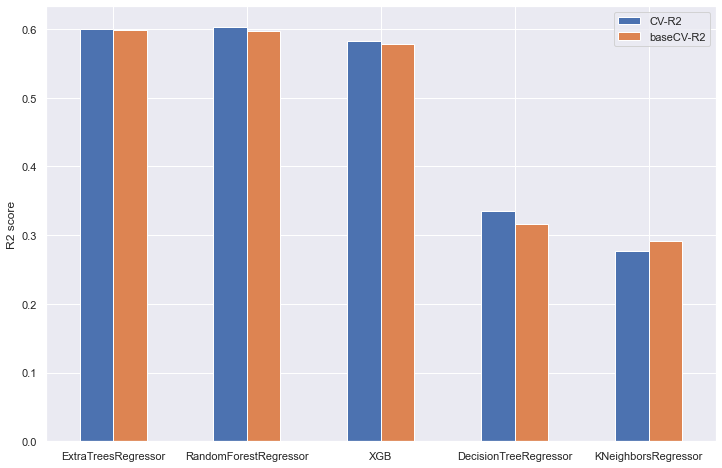

In [126]:
ax=summary_days2_comDF.plot( y=['CV-R2','baseCV-R2'], kind="bar",rot=0,figsize=(12,8))
ax.set_ylabel("R2 score");

# Feature selection

## SciKit learn KBest

In [56]:
bestfeatures = SelectKBest(score_func=f_regression, k=35)
fit = bestfeatures.fit(X_org,y_org)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X_org.columns)
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']
feature_list=featureScores.nlargest(35,'Score')['Specs'].tolist()

In [57]:
X_kbest35=X_org[feature_list]
X_kbest30=X_org[feature_list[:30]]
X_kbest25=X_org[feature_list[:25]]
X_kbest20=X_org[feature_list[:20]]
X_kbest15=X_org[feature_list[:15]]

In [59]:
summary_k35DF=templateDF.copy()
summary_k30DF=templateDF.copy()
summary_k25DF=templateDF.copy()
summary_k20DF=templateDF.copy()
summary_k15DF=templateDF.copy()

In [60]:
for name,regressor in regressor_dict.items():
    regresion_analysis(regressor,X_kbest35,y_org,name,summary_k35DF,train=0.8)

XGB: 
DecisionTreeRegressor: 
RandomForestRegressor: 
KNeighborsRegressor: 
ExtraTreesRegressor: 


In [61]:
summary_k35DF.to_pickle('summary_k35DF.pkl')
summary_k35DF.sort_values('CV-R2', ascending=False)

,R2,MAE,MSE,CV-R2,baseCV-R2
RandomForestRegressor,0.550436,4.04333,455.456,0.60345,0.597131
ExtraTreesRegressor,0.580041,4.07035,425.463,0.599257,0.599296
XGB,0.585612,3.9924,419.82,0.583117,0.57844
KNeighborsRegressor,0.226135,5.53726,784.007,0.307166,0.291306
DecisionTreeRegressor,0.300154,5.21811,709.019,0.245935,0.316316


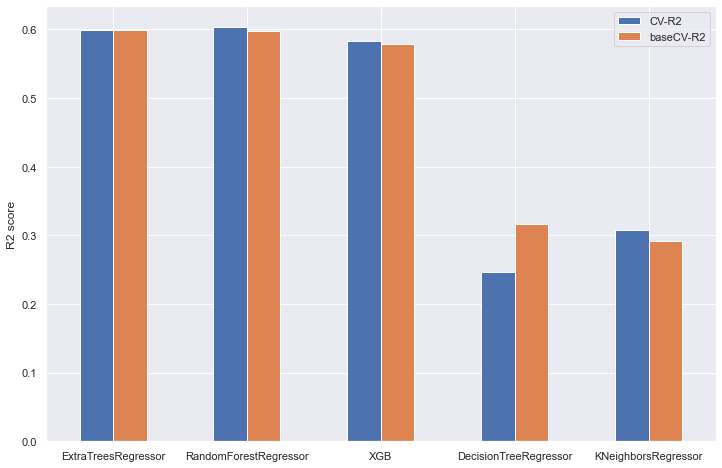

In [125]:
ax=summary_k35DF.plot( y=['CV-R2','baseCV-R2'], kind="bar",rot=0,figsize=(12,8))
ax.set_ylabel("R2 score");

In [63]:
for name,regressor in regressor_dict.items():
    regresion_analysis(regressor,X_kbest30,y_org,name,summary_k30DF,train=0.8)

XGB: 
DecisionTreeRegressor: 
RandomForestRegressor: 
KNeighborsRegressor: 
ExtraTreesRegressor: 


In [64]:
summary_k30DF.to_pickle('summary_k30DF.pkl')
summary_k30DF.sort_values('CV-R2', ascending=False)

,R2,MAE,MSE,CV-R2,baseCV-R2
RandomForestRegressor,0.571912,4.10527,433.699,0.589159,0.597131
ExtraTreesRegressor,0.591038,4.0224,414.322,0.58702,0.599296
XGB,0.579288,4.07402,426.227,0.546962,0.57844
KNeighborsRegressor,0.241244,5.36527,768.7,0.315836,0.291306
DecisionTreeRegressor,0.319015,5.22418,689.911,0.311585,0.316316


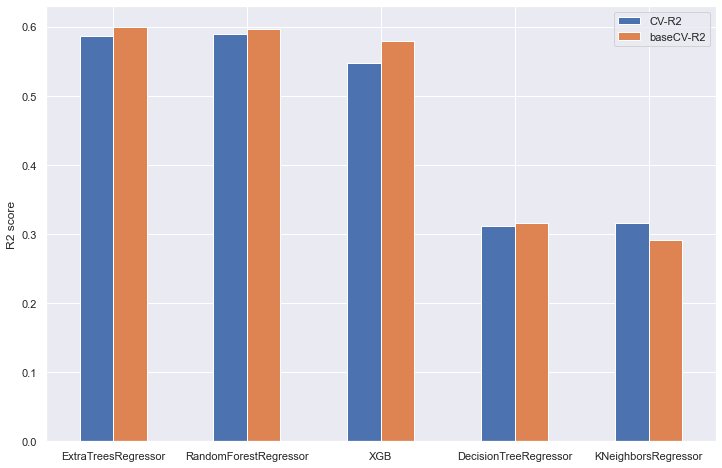

In [124]:
ax=summary_k30DF.plot( y=['CV-R2','baseCV-R2'], kind="bar",rot=0,figsize=(12,8))
ax.set_ylabel("R2 score");

In [66]:
for name,regressor in regressor_dict.items():
    regresion_analysis(regressor,X_kbest25,y_org,name,summary_k25DF,train=0.8)

XGB: 
DecisionTreeRegressor: 
RandomForestRegressor: 
KNeighborsRegressor: 
ExtraTreesRegressor: 


In [67]:
summary_k25DF.to_pickle('summary_k25DF.pkl')
summary_k25DF.sort_values('CV-R2', ascending=False)

,R2,MAE,MSE,CV-R2,baseCV-R2
ExtraTreesRegressor,0.445603,4.3758,561.663,0.557533,0.599296
RandomForestRegressor,0.48196,4.34013,524.829,0.554836,0.597131
XGB,0.424254,4.37271,583.292,0.530242,0.57844
KNeighborsRegressor,0.229986,5.48457,780.107,0.281165,0.291306
DecisionTreeRegressor,0.132221,5.49873,879.153,0.214334,0.316316


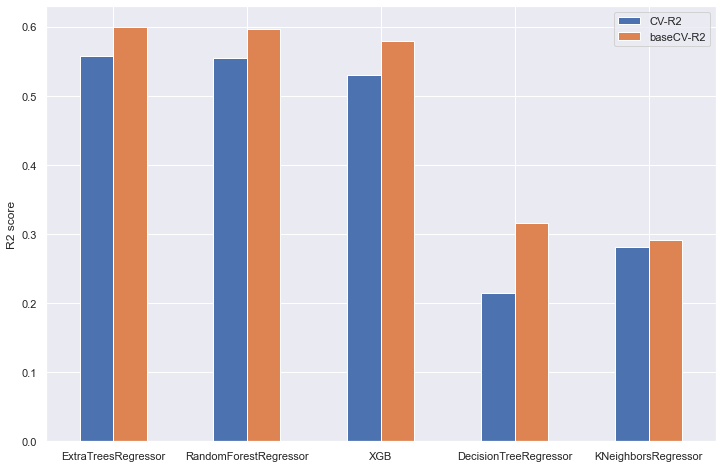

In [123]:
ax=summary_k25DF.plot( y=['CV-R2','baseCV-R2'], kind="bar",rot=0,figsize=(12,8))
ax.set_ylabel("R2 score");

In [69]:
for name,regressor in regressor_dict.items():
    regresion_analysis(regressor,X_kbest20,y_org,name,summary_k20DF,train=0.8)

XGB: 
DecisionTreeRegressor: 
RandomForestRegressor: 
KNeighborsRegressor: 
ExtraTreesRegressor: 


In [70]:
summary_k20DF.to_pickle('summary_k20DF.pkl')
summary_k20DF.sort_values('CV-R2', ascending=False)

,R2,MAE,MSE,CV-R2,baseCV-R2
RandomForestRegressor,0.112201,6.34943,899.435,0.286274,0.597131
ExtraTreesRegressor,0.00686892,6.47509,1006.15,0.284321,0.599296
XGB,0.0301491,6.41816,982.562,0.204753,0.57844
KNeighborsRegressor,0.134279,6.55907,877.067,0.196396,0.291306
DecisionTreeRegressor,-0.438818,7.66799,1457.68,-0.0898412,0.316316


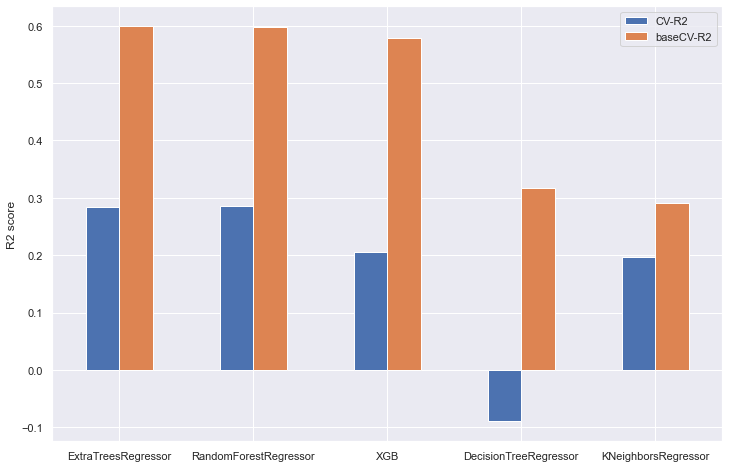

In [122]:
ax=summary_k20DF.plot( y=['CV-R2','baseCV-R2'], kind="bar",rot=0,figsize=(12,8))
ax.set_ylabel("R2 score");

In [72]:
for name,regressor in regressor_dict.items():
    regresion_analysis(regressor,X_kbest15,y_org,name,summary_k15DF,train=0.8)

XGB: 
DecisionTreeRegressor: 
RandomForestRegressor: 
KNeighborsRegressor: 
ExtraTreesRegressor: 


In [73]:
summary_k15DF.to_pickle('summary_k15DF.pkl')
summary_k15DF.sort_values('CV-R2', ascending=False)

,R2,MAE,MSE,CV-R2,baseCV-R2
ExtraTreesRegressor,-0.0188566,6.45886,1032.21,0.277354,0.599296
RandomForestRegressor,0.103276,6.3495,908.477,0.274441,0.597131
KNeighborsRegressor,0.0826468,6.80735,929.376,0.232646,0.291306
XGB,0.0222308,6.43301,990.584,0.204959,0.57844
DecisionTreeRegressor,-0.43174,7.56874,1450.51,-0.250167,0.316316


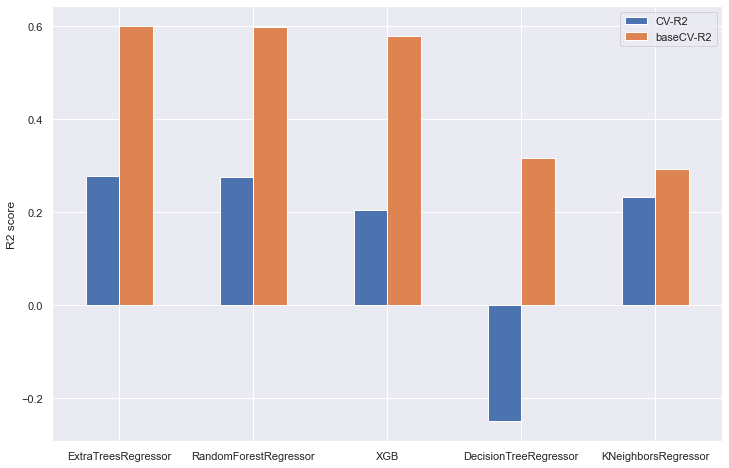

In [121]:
ax=summary_k15DF.plot( y=['CV-R2','baseCV-R2'], kind="bar",rot=0,figsize=(12,8))
ax.set_ylabel("R2 score");

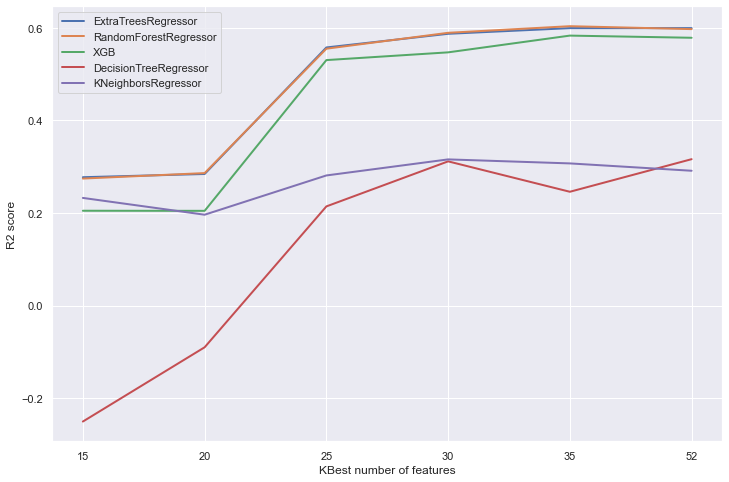

In [120]:
summary_k20DF['CV-R2']
plotDF=pd.concat([summary_k15DF['CV-R2'],summary_k20DF['CV-R2'],summary_k25DF['CV-R2'],summary_k30DF['CV-R2'],summary_k35DF['CV-R2'],summary_k35DF['baseCV-R2']],axis=1)
plotDF.columns=['15','20','25','30','35','52']
ax=plotDF.transpose().plot(lw=2,figsize=(12,8))
ax.set_xlabel("KBest number of features")
ax.set_ylabel("R2 score");

# PCA

In [76]:
X_pca=data.iloc[:,0:-1]
y_pca=data.iloc[:,-1:]

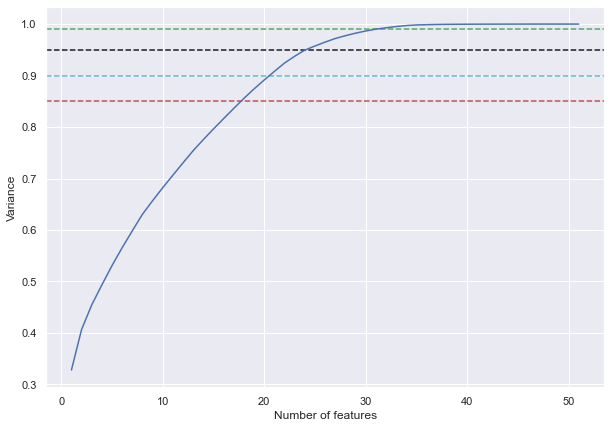

In [77]:
pcaDF=find_PCA(X_pca)

In [94]:
num_dict={
    '80':pcaDF[pcaDF['PCA%'].gt(0.80)].index[0],
    '90':pcaDF[pcaDF['PCA%'].gt(0.90)].index[0],
    '99':pcaDF[pcaDF['PCA%'].gt(0.99)].index[0]
}

In [100]:
results=[]
for name,regressor in regressor_dict.items():
    df=test_PCA(X_pca,y_pca,regressor,num_dict)
    results.append([df.iloc[0,-2],df.iloc[1,-2],df.iloc[0,-2]])
    print(results)

[[0.027537398669957792, 0.24822157059886923, 0.027537398669957792]]
[[0.027537398669957792, 0.24822157059886923, 0.027537398669957792], [-0.7881147522710259, -0.44284648266491117, -0.7881147522710259]]
[[0.027537398669957792, 0.24822157059886923, 0.027537398669957792], [-0.7881147522710259, -0.44284648266491117, -0.7881147522710259], [0.1296235058259588, 0.26893104069778373, 0.1296235058259588]]
[[0.027537398669957792, 0.24822157059886923, 0.027537398669957792], [-0.7881147522710259, -0.44284648266491117, -0.7881147522710259], [0.1296235058259588, 0.26893104069778373, 0.1296235058259588], [0.2461979846439668, 0.2744669877501912, 0.2461979846439668]]
[[0.027537398669957792, 0.24822157059886923, 0.027537398669957792], [-0.7881147522710259, -0.44284648266491117, -0.7881147522710259], [0.1296235058259588, 0.26893104069778373, 0.1296235058259588], [0.2461979846439668, 0.2744669877501912, 0.2461979846439668], [0.26598483813907625, 0.3138160837216428, 0.26598483813907625]]


In [103]:
PCA_DF=pd.DataFrame(results,columns=list(num_dict.keys()),index=list(regressor_dict.keys()))

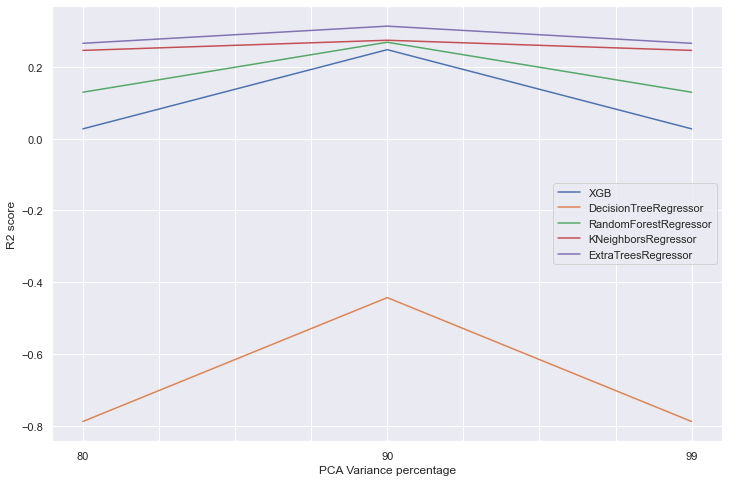

In [118]:
ax =(PCA_DF.T).plot(figsize=(12,8))
ax.set_xlabel("PCA Variance percentage")
ax.set_ylabel("R2 score")
ax.legend(loc='best');

# Step forward/bacward feature selection

In [14]:
X_sffs=data.iloc[:,0:-1]
y_sffs=data.iloc[:,-1:]

In [10]:
ssfDF=templateDF.copy()

ith 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:   15.7s
[Parallel(n_jobs=-1)]: Done  52 out of  52 | elapsed:   23.1s finished

[2021-01-14 06:07:06] Features: 1/15 -- score: 0.17611163012451883[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:   16.9s
[Parallel(n_jobs=-1)]: Done  51 out of  51 | elapsed:   29.1s finished

[2021-01-14 06:07:36] Features: 2/15 -- score: 0.42398737649042467[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:   20.6s
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:   34.6s finished

[2021-01-14 06:08:10] Features: 3/15 -- score: 0.5615958248411413[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:   23.3s
[Parallel(n_jobs=-1)]: Done  49 out of  49 | elapsed:   38.9s finished

[2021-01-14 0

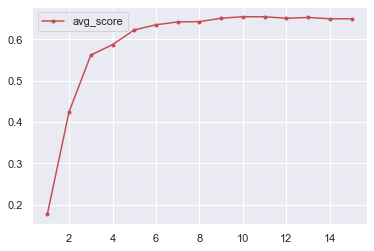

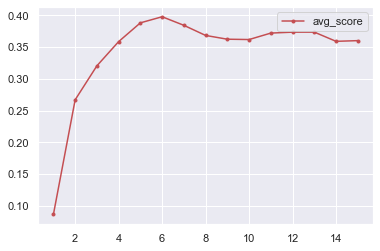

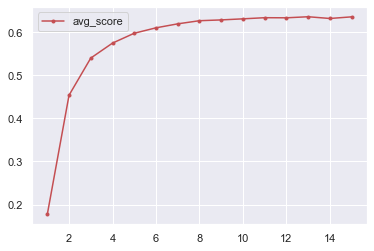

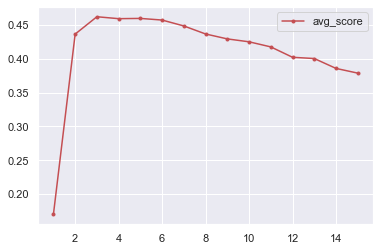

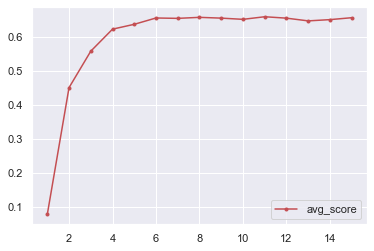

In [11]:
for name,regressor in regressor_dict.items():
    features=stepFeatureSelect(X_sffs,y_sffs,regressor,num_features=15, direction=True)
    X_bestF=X_sffs[features]
    regresion_analysis(regressor,X_bestF,y_sffs,name,ssfDF,train=0.8)

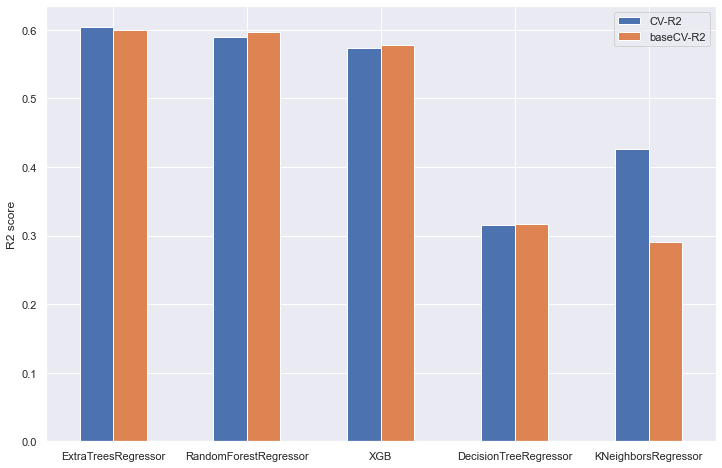

In [13]:
ax=ssfDF.plot( y=['CV-R2','baseCV-R2'], kind="bar",rot=0,figsize=(12,8))
ax.set_ylabel("R2 score");

In [45]:
experimentDF=pd.DataFrame(ssfDF,columns=list(ssfDF.columns).remove('baseCV-R2'), index=['LinearRegression','Lasso','Ridge','TweedieRegressor'])

In [46]:
experimentDF['baseCV-R2']=summaryDF.loc[['LinearRegression','Lasso','Ridge','TweedieRegressor'],['CV-R2']]

In [47]:
experiment_dict={
    'LinearRegression':LinearRegression(),
    'Lasso':Lasso(),
    'Ridge':Ridge(),
    'TweedieRegressor':TweedieRegressor()
}

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  52 out of  52 | elapsed:    0.4s finished

[2021-01-14 07:34:49] Features: 1/15 -- score: 0.2672329208042156[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  36 out of  51 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=-1)]: Done  51 out of  51 | elapsed:    0.3s finished

[2021-01-14 07:34:50] Features: 2/15 -- score: 0.28149995416944834[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  50 out of  50 | elapsed:    0.5s finished

[2021-01-14 07:34:50] Features: 3/15 -- score: 0.296511876607043[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 out of  49 | elapsed:    0.4s remaining:    0.1s
[Parallel(n_jobs=-1)]: Done  49 out of  49 | elapsed:    0.5s finished

[2021-01-14 07:34:51] Features: 4/15 -- score: 0.29

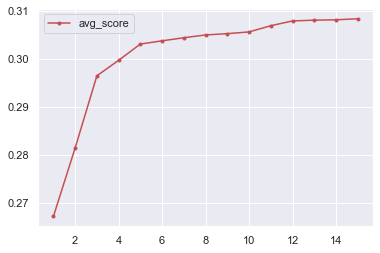

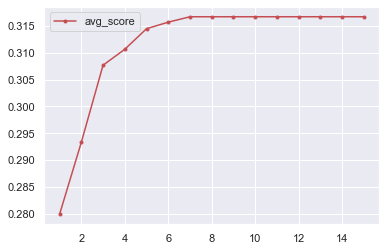

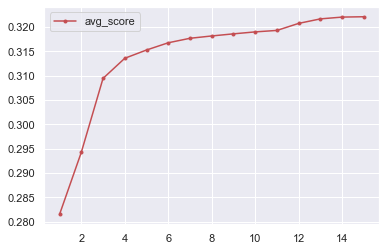

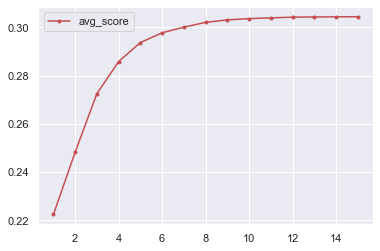

In [48]:
for name,regressor in experiment_dict.items():
    features=stepFeatureSelect(X_sffs,y_sffs,regressor,num_features=15, direction=True)
    X_bestF=X_sffs[features]
    regresion_analysis(regressor,X_bestF,y_sffs,name,experimentDF,train=0.8)

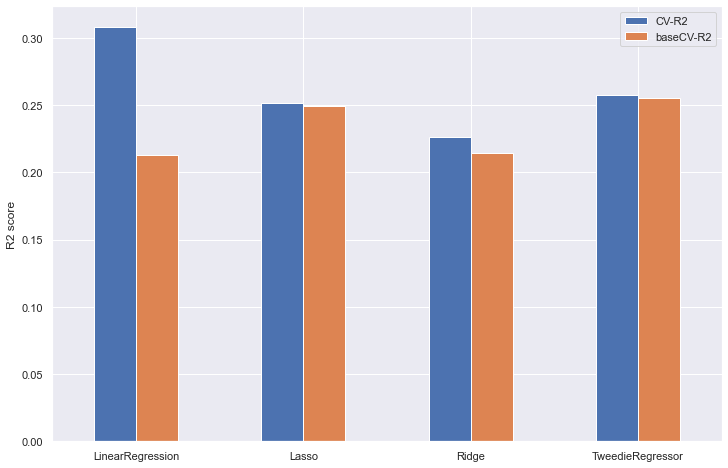

In [49]:
ax=experimentDF.plot( y=['CV-R2','baseCV-R2'], kind="bar",rot=0,figsize=(12,8))
ax.set_ylabel("R2 score");

# Parameters search

In [13]:
X_ps=data.iloc[:,0:-1]
y_ps=data.iloc[:,-1:]

In [16]:
par_searchDF=templateDF.copy()
par_searchDF.drop(['R2','MAE','MSE','CV-R2'],axis=1,inplace=True)

,baseCV-R2
ExtraTreesRegressor,0.599296
RandomForestRegressor,0.597131
XGB,0.57844
DecisionTreeRegressor,0.316316
KNeighborsRegressor,0.291306


In [21]:
param_dict=dict()
param_dict['extratreesregressor__n_estimators']=range(20,121,20)
param_dict['extratreesregressor__max_depth']=range(10,61,10)
ertCV,ertFEAT=RandSearch(X_ps,y_ps,ExtraTreesRegressor(random_state=1),param_dict, n_iter=10,cv=4)
print(ertCV)
ertFEAT

0.607109978813378


{'extratreesregressor__n_estimators': 80, 'extratreesregressor__max_depth': 10}

In [30]:
param_dict=dict()
param_dict['decisiontreeregressor__max_depth']=range(10,140,20)
param_dict['decisiontreeregressor__criterion']=['mae','mse']
DTRcv,DTRfeatures=RandSearch(X_ps,y_ps,DecisionTreeRegressor(random_state=1),param_dict, n_iter=4)
print(DTRcv)
DTRfeatures

0.3189505210548869


{'decisiontreeregressor__max_depth': 10,
 'decisiontreeregressor__criterion': 'mse'}

In [23]:
param_dict=dict()
param_dict['xgbregressor__max_depth']=[3,5,7]
param_dict['xgbregressor__lambda']=[0,1]
param_dict['xgbregressor__alpha']=[0,1]
param_dict['xgbregressor__eta']=[0.3,0.5,0.8]
XGBcv,XGBfeatures=RandSearch(X_ps,y_ps,xgb.XGBRegressor(),param_dict, n_iter=30)
print(XGBcv)
XGBfeatures

0.5986867923483798


{'xgbregressor__max_depth': 5,
 'xgbregressor__lambda': 1,
 'xgbregressor__eta': 0.3,
 'xgbregressor__alpha': 0}

In [26]:
param_dict=dict()
param_dict['randomforestregressor__max_depth']=range(10,51,10)
param_dict['randomforestregressor__n_estimators']=range(20,81,20)
RFRcv,RFRfeatures=RandSearch(X_ps,y_ps,RandomForestRegressor(random_state=1,n_jobs=-1),param_dict, n_iter=20)
print(RFRcv)
RFRfeatures

0.6045900580525364


{'randomforestregressor__n_estimators': 40,
 'randomforestregressor__max_depth': 10}

In [27]:
param_dict=dict()
param_dict['kneighborsregressor__n_neighbors']=range(2,11,2)
param_dict['kneighborsregressor__weights']=['uniform', 'distance']
KNRcv,KNRfeatures=RandSearch(X_ps,y_ps,KNeighborsRegressor(n_jobs=-1),param_dict, n_iter=20)
print(KNRcv)
KNRfeatures

0.3167824267746528


{'kneighborsregressor__weights': 'distance',
 'kneighborsregressor__n_neighbors': 8}

In [34]:
par_searchDF['newCV-R2']=[ertCV,RFRcv,XGBcv,DTRcv,KNRcv]

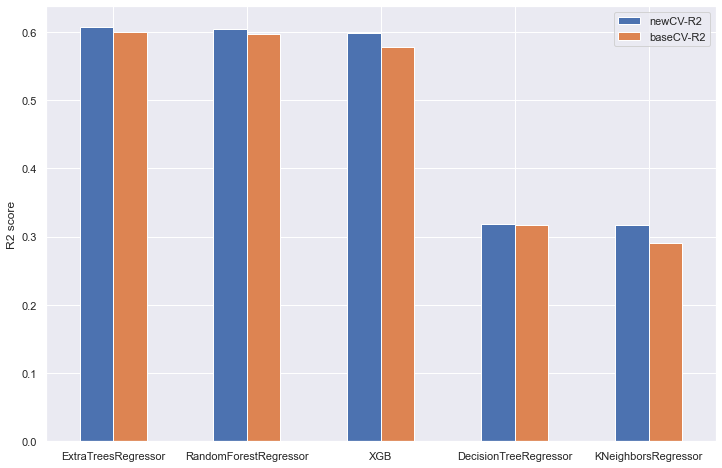

In [35]:
ax=par_searchDF.plot( y=['newCV-R2','baseCV-R2'], kind="bar",rot=0,figsize=(12,8))
ax.set_ylabel("R2 score");